**Nama: Nurfadillah Umar**

**NIM : D121221022**

# Program Utama

In [1]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# ===================================
# 1. DEFINISI KERNEL SOBEL
# ===================================
sobel_x = np.array([
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1]
])

sobel_y = np.array([
    [-1, -2, -1],
    [ 0,  0,  0],
    [ 1,  2,  1]
])

# ===================================
# 2. FUNGSI KONVOLUSI (untuk Sobel)
# ===================================
def convolve(image, kernel):
    """Melakukan konvolusi kernel 3x3 ke citra grayscale."""
    h, w = image.shape
    output = np.zeros_like(image, dtype=np.float64)

    # Padding 1 piksel di tiap sisi
    padded = np.pad(image, ((1, 1), (1, 1)), mode='constant', constant_values=0)

    # Geser kernel ke seluruh piksel
    for y in range(h):
        for x in range(w):
            region = padded[y:y+3, x:x+3]
            output[y, x] = np.sum(region * kernel)

    return output

# ===================================
# 3. DETEKSI TEPI DENGAN SOBEL
# ===================================
def sobel_edge_detection(gray):
    """Deteksi tepi menggunakan kernel Sobel"""
    gray = gray.astype(np.float64)

    grad_x = convolve(gray, sobel_x)
    grad_y = convolve(gray, sobel_y)

    magnitude = np.sqrt(grad_x**2 + grad_y**2)
    magnitude = (magnitude / magnitude.max()) * 255
    magnitude = magnitude.astype(np.uint8)

    # Thresholding
    threshold = 50
    edge = np.zeros_like(magnitude, dtype=np.uint8)
    edge[magnitude > threshold] = 255

    return edge

# ===================================
# 4. URUTKAN TITIK-TITIK SUDUT (ORDER POINTS)
# ===================================
def order_points(pts):
    """Mengurutkan 4 titik dalam urutan: top-left, top-right, bottom-right, bottom-left"""
    rect = np.zeros((4, 2), dtype="float32")
    s = pts.sum(axis=1)
    diff = np.diff(pts, axis=1)

    rect[0] = pts[np.argmin(s)]       # top-left
    rect[2] = pts[np.argmax(s)]       # bottom-right
    rect[1] = pts[np.argmin(diff)]    # top-right
    rect[3] = pts[np.argmax(diff)]    # bottom-left

    return rect

# ===================================
# 5. TRANSFORMASI PERSPEKTIF
# ===================================
def four_point_transform(image, pts):
    """Meluruskan gambar (seperti hasil scanner) berdasarkan 4 titik."""
    rect = order_points(pts)
    (tl, tr, br, bl) = rect

    widthA = np.linalg.norm(br - bl)
    widthB = np.linalg.norm(tr - tl)
    maxWidth = max(int(widthA), int(widthB))

    heightA = np.linalg.norm(tr - br)
    heightB = np.linalg.norm(tl - bl)
    maxHeight = max(int(heightA), int(heightB))

    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]
    ], dtype="float32")

    M = cv2.getPerspectiveTransform(rect, dst)
    warped = cv2.warpPerspective(image, M, (maxWidth, maxHeight))

    return warped

# ===================================
# 6. FUNGSI UTAMA SCAN DOKUMEN
# ===================================
def scan_document_manual_kernel(image_path):
    """Fungsi utama"""
    image = cv2.imread(image_path)
    if image is None:
        raise Exception("Gambar tidak ditemukan. Periksa path-nya.")

    orig = image.copy()
    ratio = image.shape[0] / 500.0
    image = cv2.resize(image, (int(image.shape[1] / ratio), 500))
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # 1. Deteksi tepi Sobel
    edged = sobel_edge_detection(gray)
    cv2_imshow(edged)
    print("Deteksi tepi selesai.")

    # 2. Deteksi kontur
    contours, _ = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]

    # 3. Cari kontur dokumen (yang memiliki 4 titik sudut)
    for c in contours:
        peri = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, 0.02 * peri, True)
        if len(approx) == 4:
            doc_cnts = approx
            break
    else:
        raise Exception("Dokumen tidak ditemukan.")

    # 4. Transformasi perspektif
    warped = four_point_transform(orig, doc_cnts.reshape(4, 2) * ratio)
    warped_gray = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)

    return warped_gray

# Gambar Dokumen dengan Pencahayaan Cukup

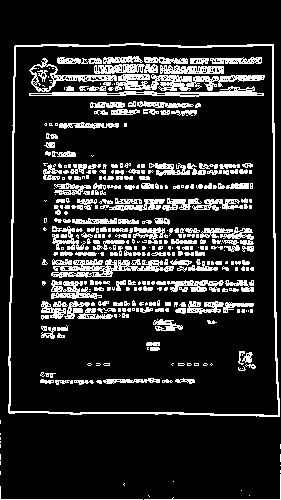

Deteksi tepi selesai.


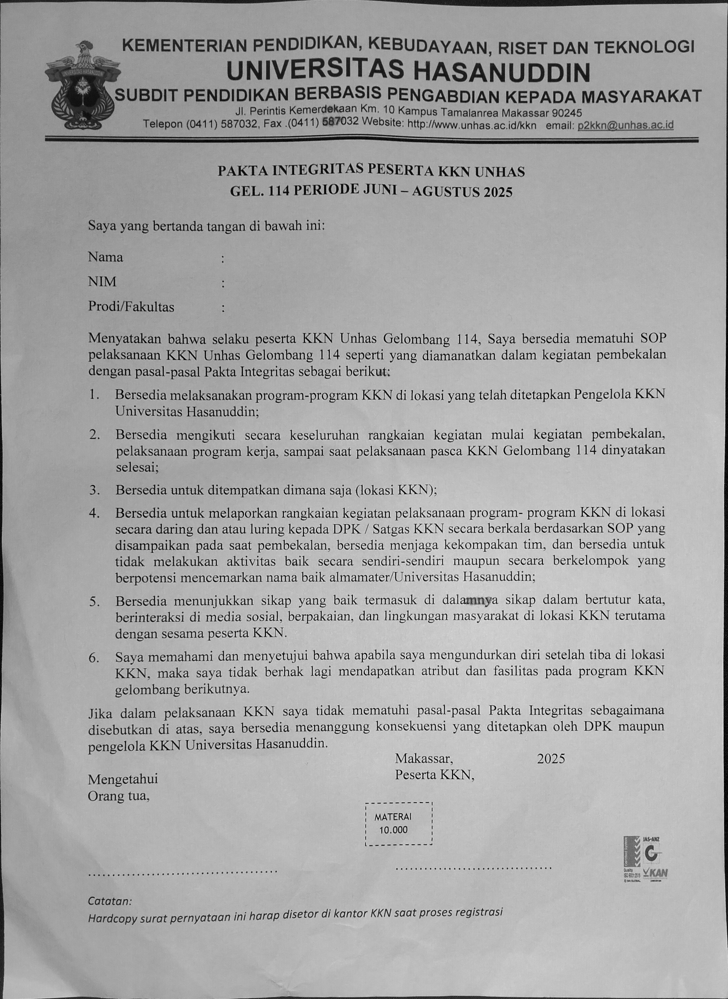

Hasil scan disimpan.


In [2]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_pencahayaan_cukup.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_pencahayaan_cukup.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen dengan Background Hampir Sama

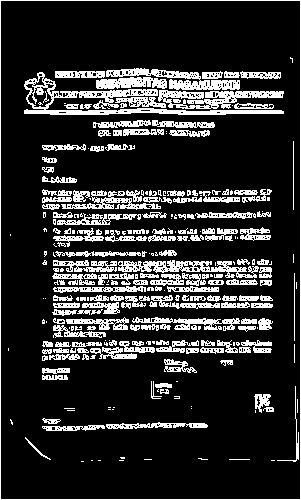

Deteksi tepi selesai.


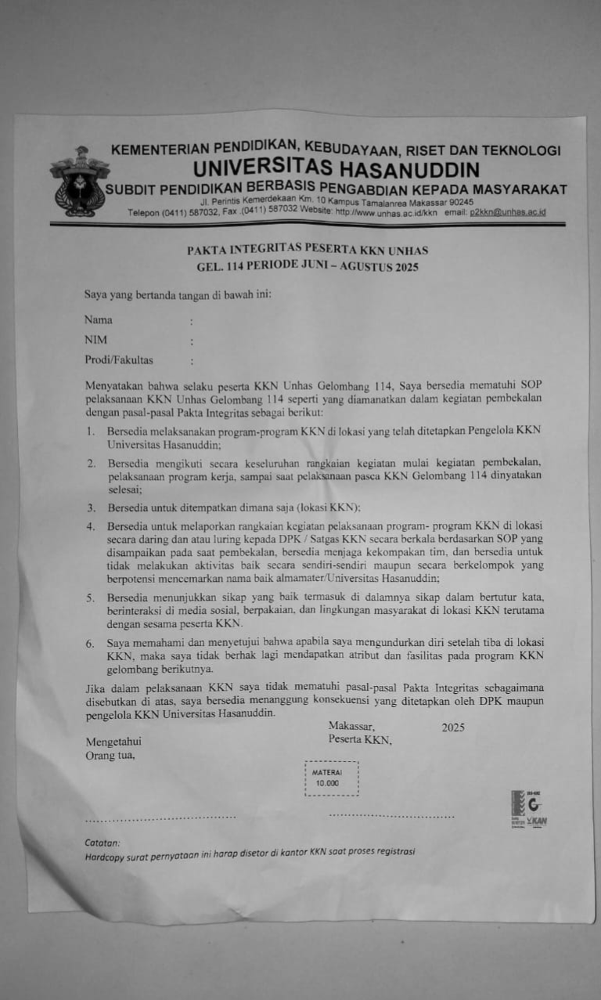

Hasil scan disimpan.


In [6]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_background_sama.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_background_sama.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen Gelap

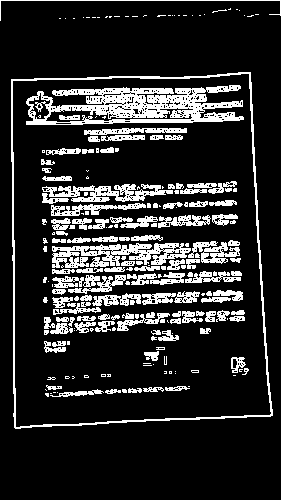

Deteksi tepi selesai.


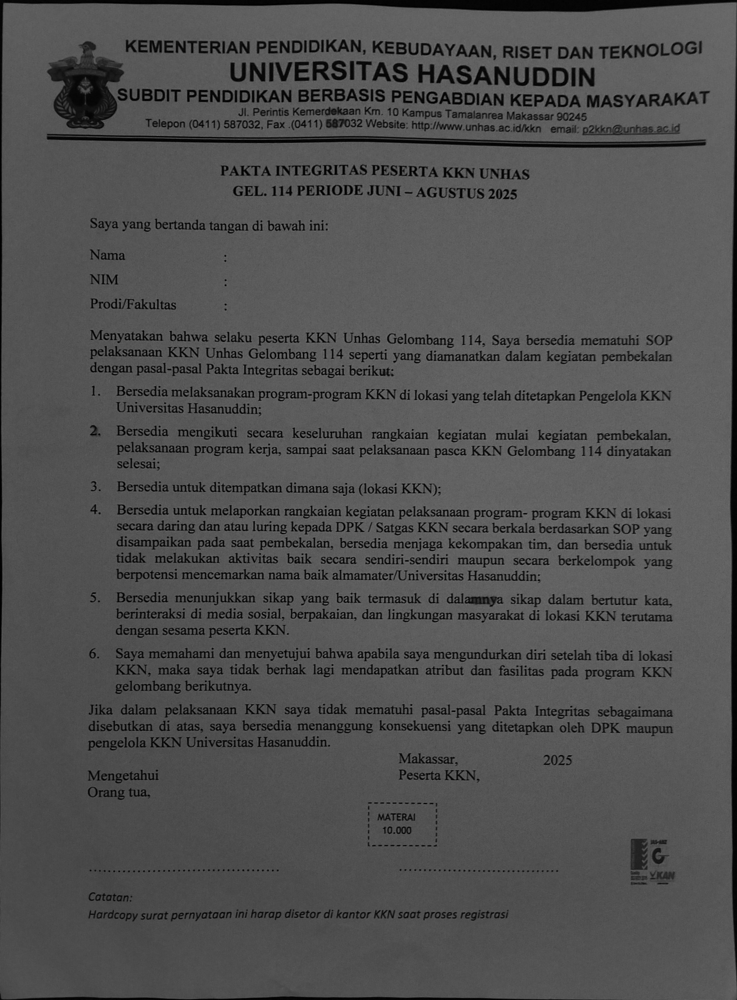

Hasil scan disimpan.


In [7]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_pencahayaan_gelap.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_pencahayaan_gelap.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen Berbayang

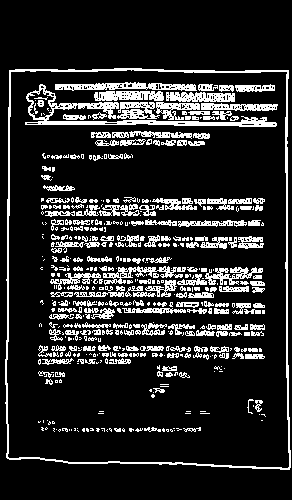

Deteksi tepi selesai.


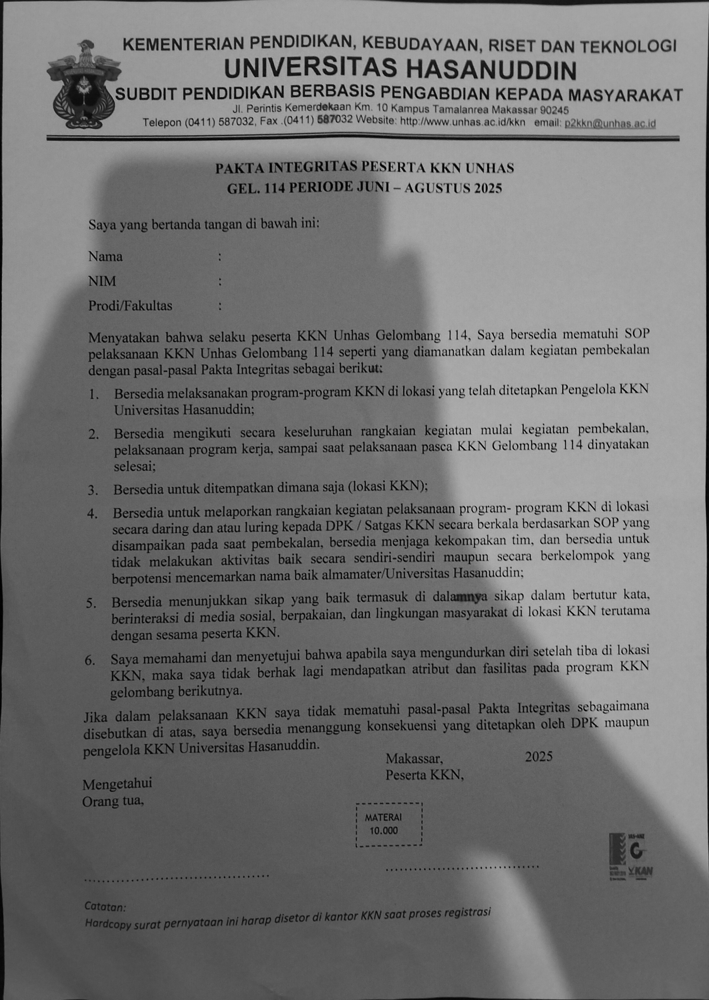

Hasil scan disimpan.


In [8]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_berbayang.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_berbayang.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen Terpotong

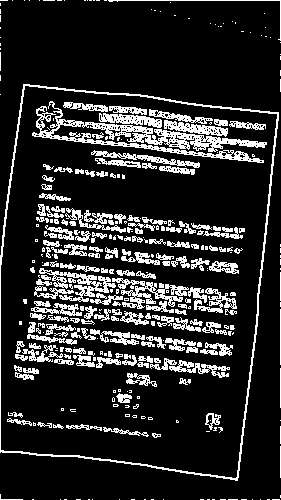

Deteksi tepi selesai.


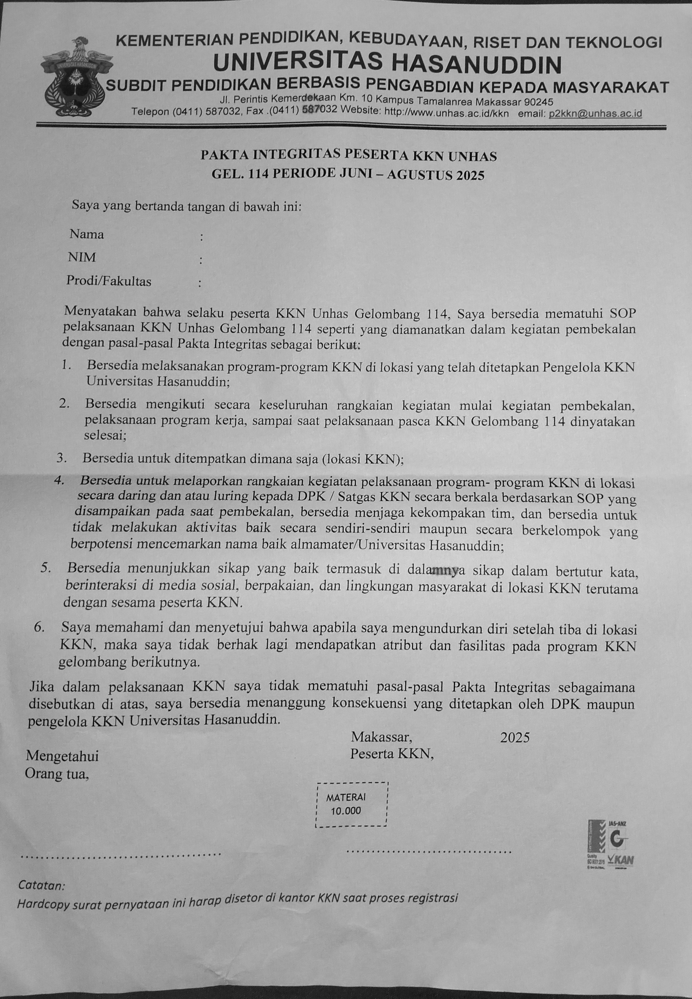

Hasil scan disimpan.


In [10]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_terpotong.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_terpotong.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen Terlipat

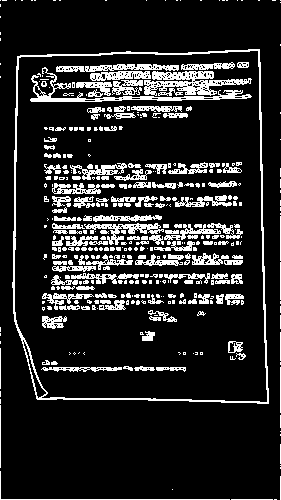

Deteksi tepi selesai.


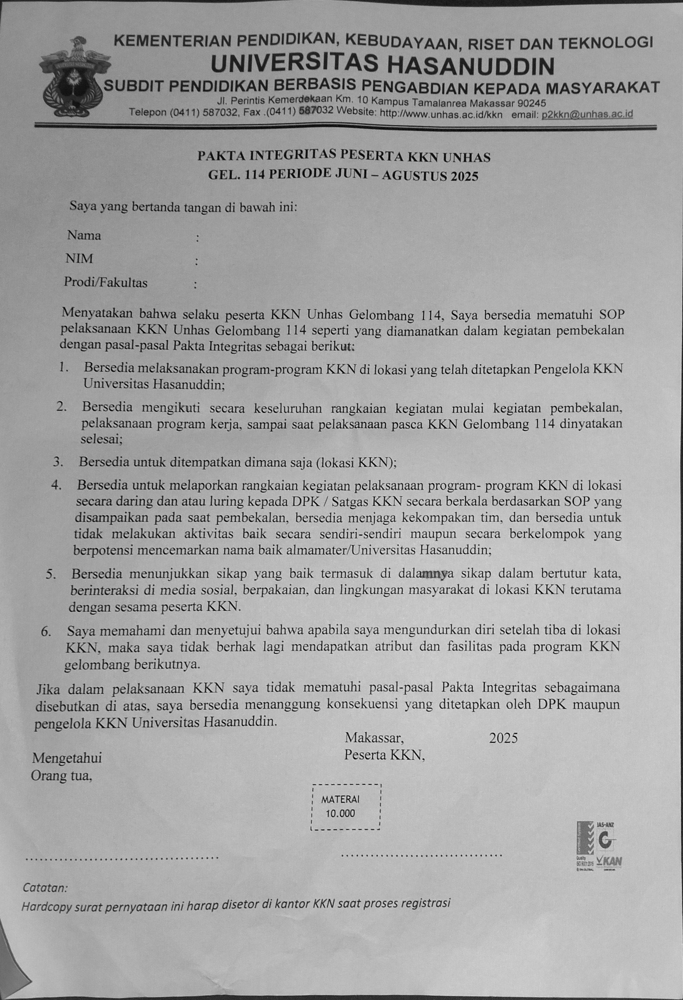

Hasil scan disimpan.


In [11]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_terlipat.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_terlipat.jpg", scanned_img)
    print("Hasil scan disimpan.")

# Gambar Dokumen Jauh

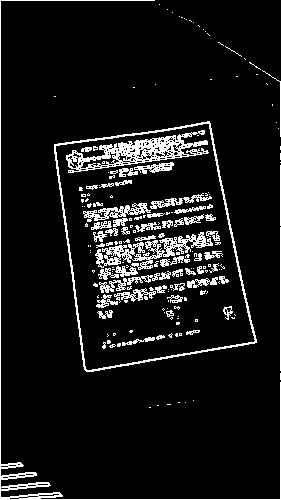

Deteksi tepi selesai.


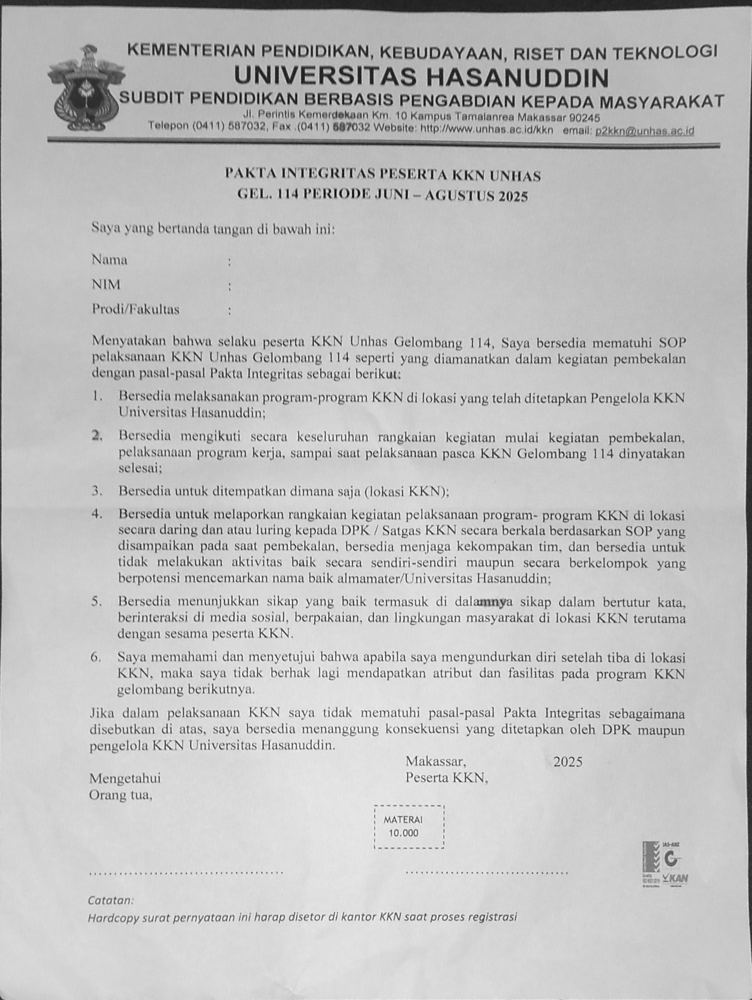

Hasil scan disimpan.


In [12]:
# ===================================
# 7. EKSEKUSI PROGRAM
# ===================================
if __name__ == "__main__":
    scanned_img = scan_document_manual_kernel("/content/dokumen_jauh.jpg")
    cv2_imshow(scanned_img)
    cv2.imwrite("/content/hasil_scan_dokumen_jauh.jpg", scanned_img)
    print("Hasil scan disimpan.")